<a href="https://colab.research.google.com/github/nikiiny/Fruits-360-Convolutional-Neural-Networks/blob/main/machine_learning_project_CNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# MACHINE LEARNING PROJECT: IMAGE CLASSIFICATION WITH NEURAL NETWORKS
Nicole Formenti DSE 

# DATA PROCESSING
## DATA DOWNLOAD FROM KAGGLE

First, donwload the dataset from Kaggle in the colab environment

In [ ]:
!pip install -q kaggle
from google.colab import files
uploaded = files.upload() #to upload kaggle.json api

Saving kaggle.json to kaggle (1).json


In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!ls ~/.kaggle

! chmod 600 ~/.kaggle/kaggle.json
! kaggle datasets list

In [ ]:
!kaggle datasets download -d moltean/fruits #download the dataset

100% 759M/760M [00:23<00:00, 21.8MB/s]
100% 760M/760M [00:23<00:00, 33.4MB/s]


Create a directory where the dataset is downloaded and remove the useless folders

In [ ]:
! mkdir dataset
! unzip fruits.zip -d dataset

In [ ]:
!rm -rf dataset/fruits-360/papers
!rm -rf dataset/fruits-360/test-multiple_fruits
!rm -rf dataset/fruits-360/LICENSE
!rm -rf dataset/fruits-360/readme.md

In [ ]:
from glob import glob
import os

Look at the name of the fruit and vegetables classes in the folders

In [ ]:
path = 'dataset/fruits-360/Test'
test_fruits = os.listdir(path)
path = 'dataset/fruits-360/Training'
training_fruits = os.listdir(path)

print('TEST FRUITS:\n')
for i in test_fruits:
  print(i)
print('\nTRAINING FRUITS:\n')
for i in training_fruits:
  print(i)

TEST FRUITS:

Potato White
Potato Red Washed
Tomato 1
Rambutan
Apple Granny Smith
Physalis with Husk
Raspberry
Banana Red
Cherry 1
Tomato Heart
Lemon
Apple Braeburn
Apple Pink Lady
Grape White 2
Corn
Plum 3
Passion Fruit
Avocado ripe
Huckleberry
Apple Red Yellow 1
Tomato not Ripened
Apple Red 3
Cherry 2
Watermelon
Pear Kaiser
Pear Abate
Tomato 3
Strawberry Wedge
Quince
Redcurrant
Pepper Orange
Papaya
Apple Red Delicious
Tomato Cherry Red
Walnut
Cantaloupe 2
Apple Red 2
Nut Pecan
Carambula
Apple Red 1
Guava
Physalis
Pomelo Sweetie
Plum
Peach Flat
Pear Williams
Fig
Apple Golden 3
Nectarine Flat
Avocado
Kohlrabi
Peach 2
Plum 2
Kumquats
Tomato 2
Ginger Root
Pear
Pepino
Tomato Yellow
Orange
Cantaloupe 1
Nut Forest
Tomato Maroon
Cherry Wax Black
Cherry Wax Yellow
Maracuja
Grape Blue
Mulberry
Chestnut
Cauliflower
Beetroot
Grapefruit White
Lychee
Onion Red
Hazelnut
Potato Red
Corn Husk
Pineapple
Pear Red
Lemon Meyer
Tamarillo
Pepper Green
Grapefruit Pink
Grape White 4
Pear Stone
Banana
Mango R

Rename the fruits in the same folder by adding the same number at the end of the file name, so that when putting all of them in one single folder there are no images with the same name

In [ ]:
i=1
for file in test_fruits:
    path = os.path.join('dataset/fruits-360/Test',file)
    filez = os.listdir(path)
    for fi in filez:
        fpath = path + '/' + fi
        os.rename(fpath,fpath[0:-4]+str(i)+'.jpg')
    i+=1

i=1
for file in training_fruits:
    path = os.path.join('dataset/fruits-360/Training/',file)
    filez = os.listdir(path)
    for fi in filez:
        fpath = path + '/' + fi
        os.rename(fpath,fpath[0:-4]+str(i)+'.jpg')
    i+=1

Check the renaming

In [ ]:
for file in test_fruits:
    path = os.path.join('dataset/fruits-360/Test/',file)
    filez = os.listdir(path)
    print(filez)

In [ ]:
for file in training_fruits:
    path = os.path.join('dataset/fruits-360/Training/',file)
    filez = os.listdir(path)
    print(filez)

Copy the files of the fruit of the same type in the one single folder. We do it only for the 10 most frequent fruits, namely Apple, Banana, Cherry, Grape, Peach, Pear, Pepper, Plum, Potato, Tomato

In [ ]:
import shutil

fruits_list = ['Apple','Banana','Cherry','Grape','Peach','Pear','Pepper','Plum','Potato','Tomato']


for fruit in fruits_list:
  if os.path.exists('dataset/fruits-360/Test/' + fruit):
    for file in test_fruits:
      if file.startswith(fruit + ' '):
        path = 'dataset/fruits-360/Test/' + file
        filez = os.listdir(path)
        for fi in filez:
          fpath = path + '/' +fi
          shutil.copyfile(fpath, 'dataset/fruits-360/Test/'+ fruit +'/'+fi)
  else:
    os.mkdir('dataset/fruits-360/Test/' + fruit)
    for file in test_fruits:
      if file.startswith(fruit + ' '):
        path = 'dataset/fruits-360/Test/' + file
        filez = os.listdir(path)
        for fi in filez:
          fpath = path + '/' +fi
          shutil.copyfile(fpath, 'dataset/fruits-360/Test/'+ fruit + '/' +fi)

  path = os.path.join('dataset/fruits-360/Test', fruit)
  print('lenght of test folder', fruit, ':',  str(len(os.listdir(path))))

lenght of test folder Apple : 2134
lenght of test folder Banana : 484
lenght of test folder Cherry : 1148
lenght of test folder Grape : 1146
lenght of test folder Peach : 574
lenght of test folder Pear : 1689
lenght of test folder Pepper : 826
lenght of test folder Plum : 597
lenght of test folder Potato : 601
lenght of test folder Tomato : 1707


In [ ]:
import shutil

fruits_list = ['Apple','Banana','Cherry','Grape','Peach','Pear','Pepper','Plum','Potato','Tomato']


for fruit in fruits_list:
  if os.path.exists('dataset/fruits-360/Training/' + fruit):
    for file in test_fruits:
      if file.startswith(fruit + ' '):
        path = 'dataset/fruits-360/Training/' + file
        filez = os.listdir(path)
        for fi in filez:
          fpath = path + '/' +fi
          shutil.copyfile(fpath, 'dataset/fruits-360/Training/'+ fruit +'/'+fi)
  else:
    os.mkdir('dataset/fruits-360/Training/' + fruit)
    for file in test_fruits:
      if file.startswith(fruit + ' '):
        path = 'dataset/fruits-360/Training/' + file
        filez = os.listdir(path)
        for fi in filez:
          fpath = path + '/' +fi
          shutil.copyfile(fpath, 'dataset/fruits-360/Training/'+ fruit + '/' +fi)

  path = os.path.join('dataset/fruits-360/Training', fruit)
  print('lenght of training folder', fruit, ':',  str(len(os.listdir(path))))

lenght of training folder Apple : 6404
lenght of training folder Banana : 1430
lenght of training folder Cherry : 3444
lenght of training folder Grape : 3419
lenght of training folder Peach : 1722
lenght of training folder Pear : 5037
lenght of training folder Pepper : 2478
lenght of training folder Plum : 1767
lenght of training folder Potato : 1803
lenght of training folder Tomato : 5103


Delete useless folders

In [ ]:
fruits_list = ['Apple','Banana','Cherry','Grape','Peach','Pear','Pepper','Plum','Potato','Tomato']

path = 'dataset/fruits-360/Test/'
for file in os.listdir(path):
    if not file in tuple(fruits_list):
      shutil.rmtree(path+file)
path = 'dataset/fruits-360/Training/'
for file in os.listdir(path):
    if not file in tuple(fruits_list):
      shutil.rmtree(path+file)

In [ ]:
path = 'dataset/fruits-360/Test/'
print('Test files:')
for file in os.listdir(path):
    print(file)

print('\nTraining files:')    
path = 'dataset/fruits-360/Training'
for file in os.listdir(path):
    print(file)

Test files:
Pepper
Cherry
Plum
Tomato
Pear
Banana
Apple
Peach
Grape
Potato

Training files:
Pepper
Cherry
Plum
Tomato
Pear
Banana
Apple
Peach
Grape
Potato


In [ ]:
train_len = 0
test_len = 0
path = 'dataset/fruits-360/Training/'
for file in os.listdir(path):
  train_len += len(os.listdir(path+file))
path = 'dataset/fruits-360/Test/'
for file in os.listdir(path):
  test_len += len(os.listdir(path+file))

print('Training set size:', train_len,'\nTest set size:',test_len)

Training set size: 32607 
Test set size: 10906


Save the downloaded files in google drive so we can retrieve them when needed

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!mv dataset/fruits-360 /content/gdrive/My\ Drive/

## PROCESS IMAGES 

Connect Colab with Google drive to access the dataset


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')
!ls

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).
gdrive	kaggle.json  sample_data


In [ ]:
from glob import glob
import os

In [ ]:
import tensorflow as tf, matplotlib.pyplot as plt, numpy as np, os
from tensorflow import keras

print("Tensorflow version " + tf.__version__)

Tensorflow version 2.3.0


Look at the name of the folders and files

In [ ]:
path = '/content/gdrive/My Drive/fruits-360/Test'
for file in os.listdir(path):
    print(file)
print('\n')
path = '/content/gdrive/My Drive/fruits-360/Training'
for file in os.listdir(path):
    print(file)

Banana
Cherry
Grape
Peach
Pear
Pepper
Plum
Potato
Tomato
Apple


Apple
Banana
Cherry
Grape
Peach
Pear
Pepper
Plum
Potato
Tomato


Check the lenght of the folders

In [ ]:
train_len = 0
test_len = 0
path = '/content/gdrive/My Drive/fruits-360/Training/'
for file in os.listdir(path):
  train_len += len(os.listdir(path+file))
path = '/content/gdrive/My Drive/fruits-360/Test/'
for file in os.listdir(path):
  test_len += len(os.listdir(path+file))

print('Training set size:', train_len,'\nTest set size:',test_len)

Training set size: 32607 
Test set size: 10906


Save paths

In [ ]:
path = '/content/gdrive/My Drive/fruits-360/Training'
training_fruits = os.listdir(path)
path = '/content/gdrive/My Drive/fruits-360/Test'
test_fruits = os.listdir(path)

fruits_names = sorted(test_fruits)
fruits_names

['Apple',
 'Banana',
 'Cherry',
 'Grape',
 'Peach',
 'Pear',
 'Pepper',
 'Plum',
 'Potato',
 'Tomato']

Scale the images in 32x32 pixels size with 3 channels and convert them into tensors, along with labels. This is necessary to feed them to convolutional neural networks

In [ ]:
from PIL import Image

x=list()
y=list()

a=1
b=0
for file in fruits_names:
  for i in os.listdir('/content/gdrive/My Drive/fruits-360/Training/' + file):
    im = Image.open('/content/gdrive/My Drive/fruits-360/Training/' + file +'/'+i)
    x.append(im)
    y.append(a) 

    b+=1
    print(b)

  print(file,': Done')
  print(a)
  a+=1

for i in range(0,len(x)):
  x[i] = tf.keras.preprocessing.image.img_to_array(x[i])
  x[i] = tf.image.resize(x[i], size=(32,32))

training_x = tf.convert_to_tensor(x)
training_labels = tf.convert_to_tensor(y,dtype=tf.int32) 

Output streaming troncato alle ultime 5000 righe.
27611
27612
27613
27614
27615
27616
27617
27618
27619
27620
27621
27622
27623
27624
27625
27626
27627
27628
27629
27630
27631
27632
27633
27634
27635
27636
27637
27638
27639
27640
27641
27642
27643
27644
27645
27646
27647
27648
27649
27650
27651
27652
27653
27654
27655
27656
27657
27658
27659
27660
27661
27662
27663
27664
27665
27666
27667
27668
27669
27670
27671
27672
27673
27674
27675
27676
27677
27678
27679
27680
27681
27682
27683
27684
27685
27686
27687
27688
27689
27690
27691
27692
27693
27694
27695
27696
27697
27698
27699
27700
27701
27702
27703
27704
27705
27706
27707
27708
27709
27710
27711
27712
27713
27714
27715
27716
27717
27718
27719
27720
27721
27722
27723
27724
27725
27726
27727
27728
27729
27730
27731
27732
27733
27734
27735
27736
27737
27738
27739
27740
27741
27742
27743
27744
27745
27746
27747
27748
27749
27750
27751
27752
27753
27754
27755
27756
27757
27758
27759
27760
27761
27762
27763
27764
27765
27766
27767
27768
27

In [ ]:
print('Training set X tensor shape:', training_x.shape)
print('Training set Y tensor shape:', training_labels.shape)

Training set X tensor shape: (32607, 32, 32, 3)
Training set Y tensor shape: (32607,)


In [ ]:
from PIL import Image

x=list()
y=list()

a=1
b=1
for file in fruits_names:
  for i in os.listdir('/content/gdrive/My Drive/fruits-360/Test/' + file):
    im = Image.open('/content/gdrive/My Drive/fruits-360/Test/' + file +'/'+i)
    x.append(im)
    y.append(a) 
    print(b)
    b+=1

  print(file,': Done')
  print(a)
  a+=1

for i in range(0,len(x)):
  x[i] = tf.keras.preprocessing.image.img_to_array(x[i])
  x[i] = tf.image.resize(x[i], size=(32,32))

test_x = tf.convert_to_tensor(x)
test_labels = tf.convert_to_tensor(y,dtype=tf.int32) 

In [ ]:
print('Test set X tensor shape:', test_x.shape)
print('Test set Y tensor shape:', test_labels.shape)

Test set X tensor shape: (10906, 32, 32, 3)
Test set Y tensor shape: (10906,)


Save the processed images files in Google Drive to retrieve them when we need to train the models

In [ ]:
!mkdir '/content/gdrive/My Drive/fruits-360/Processed_data_fruits-360'

In [ ]:
import pickle
with open('/content/gdrive/My Drive/fruits-360/Processed_data_fruits-360/Training_labels', 'wb') as f:
    pickle.dump(training_labels, f)
    f.close()

with open('/content/gdrive/My Drive/fruits-360/Processed_data_fruits-360/Training_x', 'wb') as f:
    pickle.dump(training_x, f)
    f.close()

In [ ]:
with open('/content/gdrive/My Drive/fruits-360/Processed_data_fruits-360/Test_x', 'wb') as f:
    pickle.dump(test_x, f)
    f.close()

with open('/content/gdrive/My Drive/fruits-360/Processed_data_fruits-360/Test_labels', 'wb') as f:
    pickle.dump(test_labels, f)
    f.close()

Download the processed images from Google Drive

In [ ]:
import pickle 
filehandler = open('/content/gdrive/My Drive/fruits-360/Processed_data_fruits-360/Test_x', 'rb') 
test_x = pickle.load(filehandler)

filehandler = open('/content/gdrive/My Drive/fruits-360/Processed_data_fruits-360/Test_labels', 'rb') 
test_labels = pickle.load(filehandler)

filehandler = open('/content/gdrive/My Drive/fruits-360/Processed_data_fruits-360/Training_x', 'rb') 
training_x = pickle.load(filehandler)

filehandler = open('/content/gdrive/My Drive/fruits-360/Processed_data_fruits-360/Training_labels', 'rb') 
training_labels = pickle.load(filehandler)

print('test x shape:', test_x.shape)
print('test y shape:', test_labels.shape)
print('training x shape:', training_x.shape)
print('training y shape:', training_labels.shape)

test x shape: (10906, 32, 32, 3)
test y shape: (10906,)
training x shape: (32607, 32, 32, 3)
training y shape: (32607,)


Show 10 random images

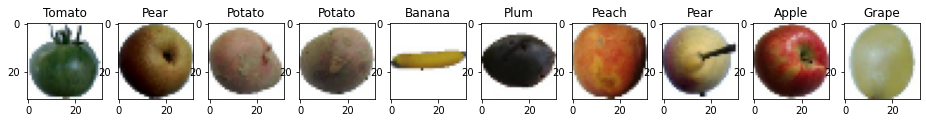

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

f, ax = plt.subplots(1, 10)
f.set_size_inches(16, 6)

for i,n in zip(range(10),np.random.randint(0,10000,size=10)):
  ax[i].imshow(test_x[n].numpy().astype("uint8"))
  index = test_labels[n]-1
  ax[i].set_title(fruits_names[index])

Process the images by:
- converting the labels to the one-hot encoding format,
- rescaling the pixel intensity values in the interval [0,1], which means normalising them

The tensor is a single image of shape 32x32 and RGB channels (3)

1. ONE HOT ENCODING


In [ ]:
number_of_classes = 10
train_set_size = training_x.shape[0]
test_set_size = test_x.shape[0]

training_labels_onehot = tf.reshape(tf.one_hot(training_labels, number_of_classes), shape = [train_set_size, number_of_classes])
test_labels_onehot = tf.reshape(tf.one_hot(test_labels, number_of_classes), shape = [test_set_size, number_of_classes])

print('training y shape:', training_labels_onehot.shape)
print('test y shape:', test_labels_onehot.shape)

training y shape: (32607, 10)
test y shape: (10906, 10)


2. RESCALE IN [0,1]

In [ ]:
normalization = tf.keras.layers.experimental.preprocessing.Rescaling(1./255)
training_x = normalization(training_x)
test_x = normalization(test_x)

print('test x shape:',test_x.shape)
print('training x shape:', training_x.shape)

test x shape: (10906, 32, 32, 3)
training x shape: (32607, 32, 32, 3)


Check if the transformation was successful by plotting the images

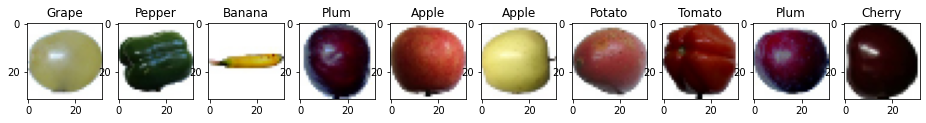

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

f, ax = plt.subplots(1, 10)
f.set_size_inches(16, 6)

for i,n in zip(range(10),np.random.randint(0,10000,size=10)):
  ax[i].imshow(test_x[n])
  index = test_labels[n]-1
  ax[i].set_title(fruits_names[index])

## AUGMENTED IMAGES 

Define functions for augmenting images

In [ ]:
def augment_1(image):
  image = tf.image.random_flip_up_down(image)
  image = tf.image.random_flip_left_right(image)
  image = tf.image.random_contrast(image,0.2, 0.9)
  return image

def augment_2(image):
  image = tf.image.resize_with_crop_or_pad(image, 45, 45) # Add 8 pixels of padding
  image = tf.image.random_crop(image, size=[32, 32, 3]) # Random crop back to 32x32
  image = tf.image.random_brightness(image, max_delta=0.5) # Random brightness
  return image

def augment_3(image):
  image = tf.image.random_crop(image, size=[25,25,3])
  image = tf.image.resize(image, size=(32,32))
  image = tf.image.random_saturation(image, 0.2,0.8)
  return image

def augment_4(image):
  image = tf.image.rot90(image, k=1)
  noise = tf.random.normal(shape=tf.shape(image), mean=0.0, stddev=0.6,
  dtype=tf.float32)
  image = tf.add(image, noise)
  return image

Try if the augmentation works

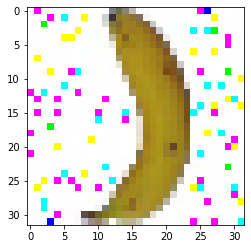

In [ ]:
from PIL import Image
im = Image.open('/content/gdrive/My Drive/fruits-360/Test/Banana/110_10042.jpg')
im = tf.keras.preprocessing.image.img_to_array(im)
im = tf.image.resize(im, size=(32,32))
im = augment_4(im)
im.shape
plt.imshow(im.numpy().astype("uint8"))


In [ ]:
import pickle 
filehandler = open('/content/gdrive/My Drive/fruits-360/Processed_data_fruits-360/Training_x', 'rb') 
training_x_aug_2 = list(pickle.load(filehandler))

filehandler = open('/content/gdrive/My Drive/fruits-360/Processed_data_fruits-360/Training_labels', 'rb') 
training_labels_aug_2 = list(pickle.load(filehandler))

Apply the augmentation on the original dataset to double it

In [ ]:
import numpy as np

np.random.seed(123)
index_1 = np.random.randint(0,len(training_x_aug_2),size = [int(np.round(len(training_x_aug_2)/2))] )
np.random.seed(0)
index_2 = np.random.randint(0,len(training_x_aug_2),size = [int(np.round(len(training_x_aug_2)/2))] )

for i in index_1:
  if i%2==0:
    aug1 = augment_1(training_x_aug_2[i])
    training_x_aug_2.append(aug1)
    training_labels_aug_2.append(training_labels_aug_2[i])
  elif i%2!=0:
    aug2 = augment_2(training_x_aug_2[i])
    training_x_aug_2.append(aug2)
    training_labels_aug_2.append(training_labels_aug_2[i])


for i in index_2:
  if i%2==0:
    aug3 = augment_3(training_x_aug_2[i])
    training_x_aug_2.append(aug3)
    training_labels_aug_2.append(training_labels_aug_2[i])
  elif i%2!=0:
    aug4 = augment_4(training_x_aug_2[i])
    training_x_aug_2.append(aug4)
    training_labels_aug_2.append(training_labels_aug_2[i])


training_x_aug_2 = tf.convert_to_tensor(training_x_aug_2)
training_labels_aug_2 = tf.convert_to_tensor(training_labels_aug_2,dtype=tf.int32) 

In [ ]:
print(training_x_aug_2.shape)
print(training_labels_aug_2.shape)

(65215, 32, 32, 3)
(65215,)


1. ONE HOT ENCODING


In [ ]:
number_of_classes = 10
train_set_size = training_x_aug_2.shape[0]

training_labels_aug_2_onehot = tf.reshape(tf.one_hot(training_labels_aug_2, number_of_classes), shape = [train_set_size, number_of_classes])

print('training y augmented shape:', training_labels_aug_2_onehot.shape)

training y augmented shape: (65215, 10)


2. RESCALE IN [0,1]

In [ ]:
normalization = tf.keras.layers.experimental.preprocessing.Rescaling(1./255)
training_x_aug_2 = normalization(training_x_aug_2)

print('training x augmented shape:', training_x_aug_2.shape)

training x augmented shape: (65215, 32, 32, 3)


Check if the transformation was successful by plotting the images

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


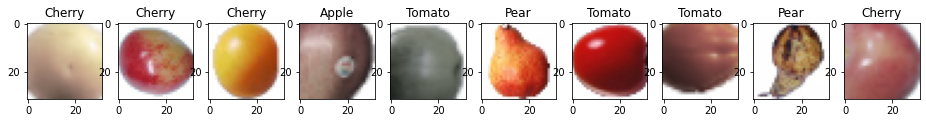

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

f, ax = plt.subplots(1, 10)
f.set_size_inches(16, 6)

for i,n in zip(range(10),np.random.randint(50000,65000,size=10)):
  ax[i].imshow(training_x_aug_2[n])
  index = training_labels_aug_2[n]-1
  ax[i].set_title(fruits_names[index])

## GRAYSCALE IMAGES 

In [ ]:
training_x_gray_aug = tf.image.rgb_to_grayscale(training_x_aug_2)
test_x_gray = tf.image.rgb_to_grayscale(test_x)
print(training_x_gray_aug.shape), print(test_x_gray.shape) 

(65215, 32, 32, 1)
(10906, 32, 32, 1)


(None, None)

Check if the transformation was successful by plotting the images

Text(0.5, 1.0, 'Pepper')

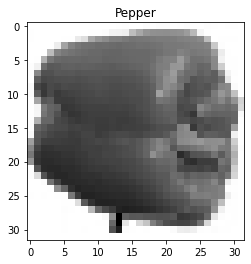

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

n= int(np.random.randint(0,60000,size=1))
plt.imshow(tf.reshape(training_x_gray_aug[n], [32, 32]), cmap = "gray")
index = training_labels_aug_2[n]-1
plt.title(fruits_names[index])

# TENSORBOARD

In [ ]:
!mkdir '/content/gdrive/My Drive/fruits-360/Processed_data_fruits-360'

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
%tensorboard --logdir "/content/gdrive/My Drive/fruits-360/conv_NN_models/VGG"

<IPython.core.display.Javascript object>

In [ ]:
%tensorboard --logdir "/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET"

Reusing TensorBoard on port 6006 (pid 5572), started 0:01:29 ago. (Use '!kill 5572' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
%tensorboard --logdir "/content/gdrive/My Drive/fruits-360/conv_NN_models/RNET"

<IPython.core.display.Javascript object>

# CNN ARCHITECTURES

## Zero-one loss function

In [ ]:
import keras.backend as K

def zero_one_loss_prop(y_true, y_pred):
  return K.cast(K.not_equal(K.argmax(y_true, axis=-1), 
                        K.argmax(y_pred, axis=-1)),
                K.floatx())

In [ ]:
import keras.backend as K

def zero_one_loss(y_true, y_pred):
  return K.sum(K.cast(K.not_equal(K.argmax(y_true, axis=-1), 
                        K.argmax(y_pred, axis=-1)),
                K.floatx()))

# VGG

## ONE BLOCK VGG

### ONE BLOCK VGG NO BATCH NORMALISATION

In [ ]:
epochs = 100
batch_size = 100

model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False, input_shape = (32, 32, 3)),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),
    
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, use_bias=False),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Dense(10, activation = 'softmax')
])

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics= [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "1_VGG_block_no_norm"

model.summary()

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/VGG", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x, training_labels_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### ONE BLOCK VGG BATCH NORMALISATION


In [ ]:
epochs = 100
batch_size = 100

model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False, input_shape = (32, 32, 3)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),
    
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Dense(10, activation = 'softmax')
])

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics= [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "1_VGG_block"

model.summary()

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/VGG", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x, training_labels_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### ONE BLOCK VGG AUGMENTED IMAGES

In [ ]:
epochs = 100
batch_size = 100

model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False, input_shape = (32, 32, 3)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),
    
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Dense(10, activation = 'softmax')
])

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics= [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "1_VGG_block_augmented"

model.summary()

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/VGG", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### ONE BLOCK VGG INCREASE LEARNING RATE

In [ ]:
adam_01 = keras.optimizers.Adam(learning_rate=0.1)

In [ ]:
epochs = 100
batch_size = 100

model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False, input_shape = (32, 32, 3)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),
    
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Dense(10, activation = 'softmax')
])

model.compile(optimizer = adam_01, loss='categorical_crossentropy', metrics= [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "1_VGG_block_augmented_learningrate_0.1"

model.summary()

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/VGG", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### ONE BLOCK VGG DECREASE LEARNING RATE

In [ ]:
adam_00001 = keras.optimizers.Adam(learning_rate=0.00001)

In [ ]:
epochs = 100
batch_size = 100

model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False, input_shape = (32, 32, 3)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),
    
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Dense(10, activation = 'softmax')
])

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics= [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "1_VGG_block_augmented_learningrate_0.00001"

model.summary()

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/VGG", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

## TWO BLOCKS VGG

### TWO BLOCKS VGG BATCH NORMALISATION

In [ ]:
epochs = 100
batch_size = 100

model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False, input_shape = (32, 32, 3)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),
    
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Dense(10, activation = 'softmax')
])


model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics= [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_VGG_block"

model.summary()

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/VGG", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x, training_labels_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### TWO BLOCKS VGG AUGMENTED IMAGES

In [ ]:
epochs = 100
batch_size = 100

model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False, input_shape = (32, 32, 3)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),
    
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Dense(10, activation = 'softmax')
])


model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics= [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_VGG_block_augmentated"

model.summary()

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/VGG", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### TWO BLOCKS VGG LEARNING RATE = 0.00001

In [ ]:
adam_00001 = keras.optimizers.Adam(learning_rate=0.00001)

In [ ]:
epochs = 100
batch_size = 100

model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False, input_shape = (32, 32, 3)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),
    
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Dense(10, activation = 'softmax')
])


model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics= [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_VGG_block_augmentated_2_learningrate_00001"

model.summary()

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/VGG", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

## THREE BLOCKS VGG

### THREE BLOCKS VGG BATCH NORMALISATION

In [ ]:
epochs = 100
batch_size = 100

model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False, input_shape = (32, 32, 3)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(128, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(128, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Dense(10, activation = 'softmax')
])

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "3_VGG_block"

model.summary()

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/VGG", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x, training_labels_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### THREE BLOCKS VGG AUGMENTED IMAGES + LEARNING RATE 0.00001 

In [ ]:
adam_00001 = keras.optimizers.Adam(learning_rate=0.00001)

In [ ]:
epochs = 100
batch_size = 100

model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False, input_shape = (32, 32, 3)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(128, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(128, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Dense(10, activation = 'softmax')
])

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "3_VGG_block_LR_0.00001"

model.summary()

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/VGG", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### THREE BLOCKS VGG WEIGHTS REGULARISATION

In [ ]:
from keras.regularizers import l2

reg_value = 0.001

epochs = 100
batch_size = 100

model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False, input_shape = (32, 32, 3),kernel_regularizer=l2(reg_value)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False,kernel_regularizer=l2(reg_value)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False,kernel_regularizer=l2(reg_value)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False,kernel_regularizer=l2(reg_value)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(128, (3, 3), padding = "same", use_bias=False, kernel_regularizer=l2(reg_value)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(128, (3, 3), padding = "same", use_bias=False, kernel_regularizer=l2(reg_value)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, use_bias=False, kernel_regularizer=l2(reg_value)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Dense(10, activation = 'softmax', kernel_regularizer=l2(reg_value))
])

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "3_VGG_block_weight_reg_0.001"

model.summary()

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/VGG", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### THREE BLOCKS VGG DROPOUT

In [ ]:
epochs = 100
batch_size = 100

model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False, input_shape = (32, 32, 3)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),
    tf.keras.layers.Dropout(0.2),

    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),
    tf.keras.layers.Dropout(0.25),

    tf.keras.layers.Conv2D(128, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(128, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),
    tf.keras.layers.Dropout(0.3),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Dropout(0.35),
    tf.keras.layers.Dense(10, activation = 'softmax')
])

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "3_VGG_block_dropout"

model.summary()

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/VGG", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)


In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### THREE BLOCKS VGG EARLY STOP

In [ ]:
epochs = 500
batch_size = 100

es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=30)

model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False, input_shape = (32, 32, 3)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(128, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(128, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Dense(10, activation = 'softmax')
])

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "3_VGG_block_early_stopping_patience_30"

model.summary()

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/VGG", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback, es], 
          verbose = 0);

### THREE BLOCKS VGG GRAYSCALE

In [ ]:
epochs = 100
batch_size = 100

model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False, input_shape = (32, 32, 1)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(128, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(128, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Dense(10, activation = 'softmax')
])

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "3_VGG_block_grayscale"

model.summary()

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/VGG", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)


In [ ]:
model.fit(training_x_gray_aug, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x_gray, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

## FOUR BLOCKS VGG

### FOUR BLOCKS VGG BATCH NORMALISATION

In [ ]:
epochs = 100
batch_size = 100

model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False, input_shape = (32, 32, 3)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(128, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(128, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(256, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(256, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(256, use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Dense(10, activation = 'softmax')
])

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "4_VGG_block"

model.summary()

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/VGG", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x, training_labels_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### FOUR BLOCKS VGG AUGMENTED IMAGES + LEARNING RATE = 0.00001

In [ ]:
adam_00001 = keras.optimizers.Adam(learning_rate=0.00001)

epochs = 100
batch_size = 100

model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False, input_shape = (32, 32, 3)),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(32, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(64, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(128, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(128, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Conv2D(256, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Conv2D(256, (3, 3), padding = "same", use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.MaxPooling2D(pool_size = (2, 2)),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(256, use_bias=False),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Activation('relu'),
    tf.keras.layers.Dense(10, activation = 'softmax')
])

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "4_VGG_block_LR_0.00001"

model.summary()

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/VGG", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

# GOOGLENET

## ONE BLOCK GOOGLENET

### ONE BLOCK GOOGLENET NO BATCH NORMALISATION (check source code)

Define the standard inception module with no batch normalisation

In [ ]:
# code source: https://www.kaggle.com/luckscylla/googlenet-implementation

from tensorflow.keras import regularizers
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Input, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.layers import Conv2D, MaxPooling2D, AveragePooling2D, ZeroPadding2D
from tensorflow.keras.layers import Concatenate
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam, SGD
from keras.layers.merge import concatenate
from keras.utils import plot_model

#it is the inception module with dimension reduction
def inception(x, filters):
    # 1x1
    path1 = Conv2D(filters=filters[0], kernel_size=(1,1), strides=1, padding='same', activation='relu')(x)

    # 1x1->3x3
    path2 = Conv2D(filters=filters[1][0], kernel_size=(1,1), strides=1, padding='same', activation='relu')(x)
    path2 = Conv2D(filters=filters[1][1], kernel_size=(3,3), strides=1, padding='same', activation='relu')(path2)
    
    # 1x1->5x5
    path3 = Conv2D(filters=filters[2][0], kernel_size=(1,1), strides=1, padding='same', activation='relu')(x)
    path3 = Conv2D(filters=filters[2][1], kernel_size=(5,5), strides=1, padding='same', activation='relu')(path3)

    # 3x3 maxpool ->1x1
    path4 = MaxPooling2D(pool_size=(3,3), strides=1, padding='same')(x)
    path4 = Conv2D(filters=filters[3], kernel_size=(1,1), strides=1, padding='same', activation='relu')(path4)

    return Concatenate(axis=-1)([path1,path2,path3,path4])


In [ ]:
def googlenet_1():
    
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)
    

    layer = inception(layer, [ 64,  (96,128), (16,32), 32])

    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model


# train model
model = googlenet_1()
model.summary()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "1_GoogleNET_no_normalisation"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x, training_labels_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### ONE BLOCK GOOGLENET BATCH NORMALISATION

In [ ]:
def googlenet_1():
    
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)
    

    layer = inception(layer, [ 64,  (96,128), (16,32), 32])
    layer = BatchNormalization()(layer)

    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model


# train model
model = googlenet_1()
model.summary()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "1_GoogleNET"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x, training_labels_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

Instructions for updating:
use `tf.profiler.experimental.stop` instead.


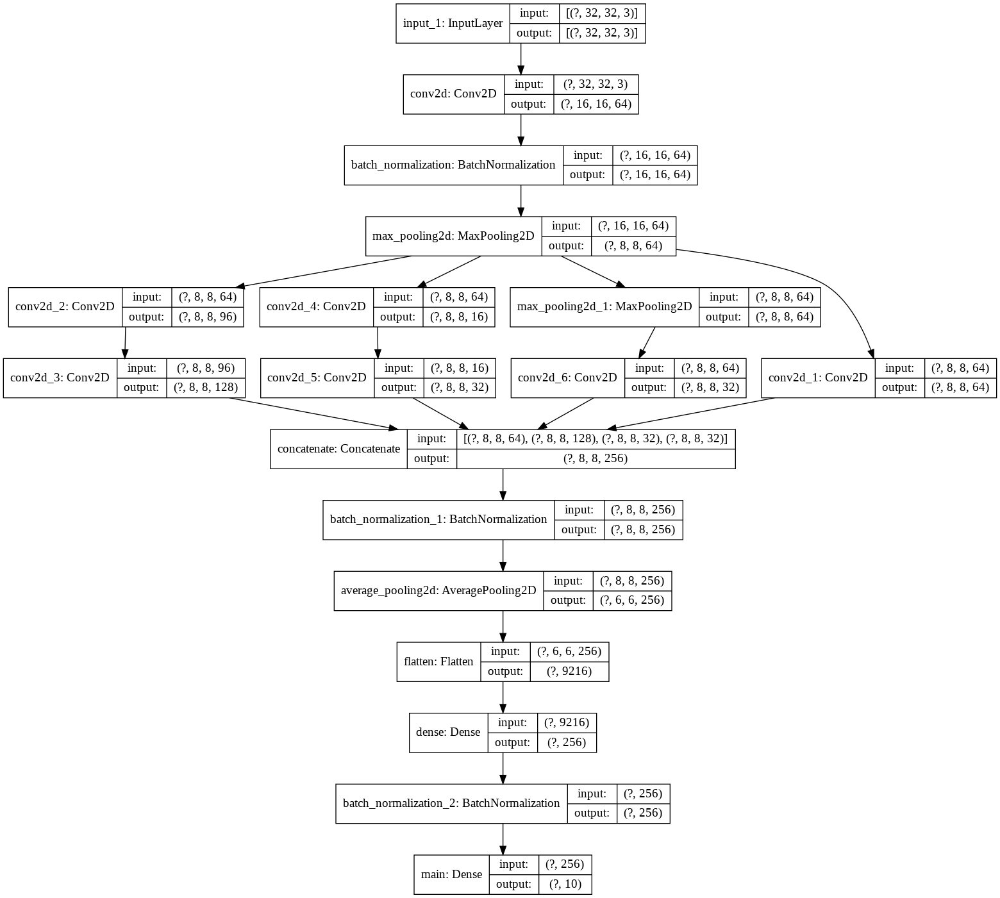

In [ ]:
import keras
keras.utils.plot_model(model, show_shapes=True)
 #1 block naive

### ONE BLOCK GOOGLENET AUGMENTED IMAGES

In [ ]:
def googlenet_1_augmented():
    
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)
    

    layer = inception(layer, [ 64,  (96,128), (16,32), 32])
    layer = BatchNormalization()(layer)

    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model


# train model
model = googlenet_1_augmented()
model.summary()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "1_GoogleNET_augmented"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### ONE BLOCK GOOGLENET DECREASE LEARNING RATE 

In [ ]:
adam_00001 = keras.optimizers.Adam(learning_rate=0.00001)

def googlenet_1_LR_00001():
    
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)
    

    layer = inception(layer, [ 64,  (96,128), (16,32), 32])
    layer = BatchNormalization()(layer)

    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model


# train model
model = googlenet_1_LR_00001()
model.summary()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "1_GoogleNET_LR_0.00001"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

## TWO BLOCKS GOOGLENET

### TWO BLOCKS GOOGLENET BATCH NORMALISATION

In [ ]:

def googlenet_2():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = inception(layer, [ 64,  (96,128), (16,32), 32]) #3a
    layer = BatchNormalization()(layer)
    layer = inception(layer, [128, (128,192), (32,96), 64]) #3b
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

# train model
model = googlenet_2()
model.summary()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_GoogleNET"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x, training_labels_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

KeyboardInterrupt: ignored

### TWO BLOCKS GOOGLENET AUGMENTED DATA

In [ ]:
def googlenet_2_augmented():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = inception(layer, [ 64,  (96,128), (16,32), 32]) #3a
    layer = BatchNormalization()(layer)
    layer = inception(layer, [128, (128,192), (32,96), 64]) #3b
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

# train model
model = googlenet_2_augmented()
model.summary()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_GoogleNET_augmented"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### TWO BLOCKS GOOGLENET LEARNING RATE = 0.00001

In [ ]:
def googlenet_2_LR_00001():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = inception(layer, [ 64,  (96,128), (16,32), 32]) 
    layer = BatchNormalization()(layer)
    layer = inception(layer, [128, (128,192), (32,96), 64]) 
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

# train model
model = googlenet_2_LR_00001()
model.summary()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_GoogleNET_LR_0.00001"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

## THREE BLOCKS GOOGLENET

### THREE BLOCKS GOOGLENET BATCH NORMALISATION

In [ ]:
def googlenet_3():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = inception(layer, [ 64,  (96,128), (16,32), 32]) #3a
    layer = BatchNormalization()(layer)
    layer = inception(layer, [128, (128,192), (32,96), 64]) #3b
    layer = BatchNormalization()(layer)

    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = inception(layer, [ 256,  (256,384), (64,192), 128]) 
    layer = BatchNormalization()(layer)

    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    layer = Conv2D(filters=64, kernel_size=(1,1), strides=1, padding='same', activation='relu')(layer_in)

    layer = Flatten()(layer)
    layer = Dense(units=384, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main]) 
    
    return model

# train model
model = googlenet_3()
model.summary()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "3_GoogleNET"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x, training_labels_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### THREE BLOCKS GOOGLENET AUGMENTED DATASET + LEARNING RATE = 0.00001 

In [ ]:
def googlenet_3_LR_00001():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = inception(layer, [ 64,  (96,128), (16,32), 32]) #3a
    layer = BatchNormalization()(layer)
    layer = inception(layer, [128, (128,192), (32,96), 64]) #3b
    layer = BatchNormalization()(layer)

    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = inception(layer, [ 256,  (256,384), (64,192), 128]) 
    layer = BatchNormalization()(layer)

    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    layer = Conv2D(filters=64, kernel_size=(1,1), strides=1, padding='same', activation='relu')(layer_in)

    layer = Flatten()(layer)
    layer = Dense(units=384, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main]) 
    
    return model

# train model
model = googlenet_3_LR_00001()
model.summary()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "3_GoogleNET_LR_0.00001"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

## ONE BLOCK NAIVENET

### ONE BLOCK NAIVENET AUGMENTED IMAGES + BATCH NORMALISATION

Define the naive inception module 

In [ ]:
# code source: https://www.kaggle.com/luckscylla/googlenet-implementation

from tensorflow.keras import regularizers
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Input, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.layers import Conv2D, MaxPooling2D, AveragePooling2D, ZeroPadding2D
from tensorflow.keras.layers import Concatenate
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam, SGD

def naive_inception(x, filters):
    # 1x1
    path1 = Conv2D(filters=filters[0], kernel_size=(1,1), strides=1, padding='same', activation='relu')(x)

    # 3x3
    path2 = Conv2D(filters=filters[1], kernel_size=(3,3), strides=1, padding='same', activation='relu')(x)
    
    # 5x5
    path3 = Conv2D(filters=filters[2], kernel_size=(5,5), strides=1, padding='same', activation='relu')(x)

    # 3x3->1x1
    path4 = MaxPooling2D(pool_size=(3,3), strides=1, padding='same')(x)

    return Concatenate(axis=-1)([path1,path2,path3,path4])


In [ ]:
def naive_net_1_augmentation():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = naive_inception(layer, [ 64, 128, 32])
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = naive_net_1_augmentation()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "1_naiveNET_augmentation"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

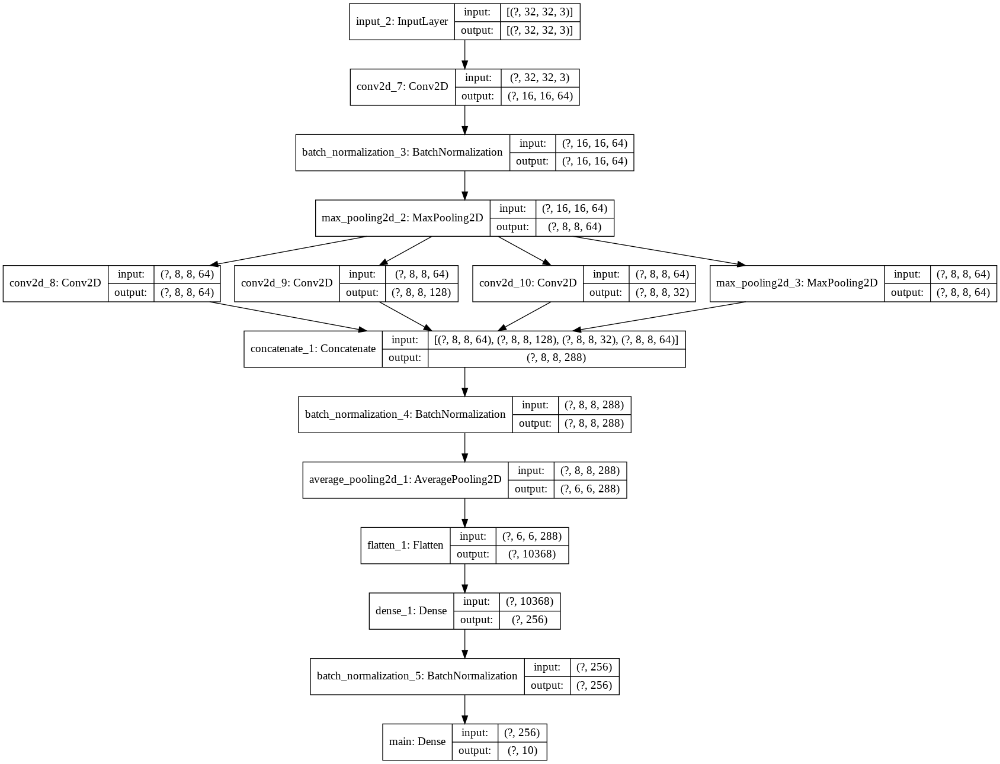

In [ ]:
import keras
keras.utils.plot_model(model, show_shapes=True)

### ONE BLOCK NAIVENET LEARNING RATE = 0.00001

In [ ]:
adam_00001 = keras.optimizers.Adam(learning_rate=0.00001)

def naive_net_1_LR_00001():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = naive_inception(layer, [ 64, 128, 32])
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = naive_net_1_LR_00001()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "1_naiveNET_LR_0.00001"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

## TWO BLOCKS NAIVENET 

### TWO BLOCKS NAIVENET BATCH NORMALISATION

In [ ]:
def naive_net_2():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = naive_inception(layer, [ 64, 128, 32])
    layer = BatchNormalization()(layer)
    layer = naive_inception(layer, [ 128, 192, 64])
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = naive_net_2()
model.summary()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "naiveNET_2"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x, training_labels_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

In [ ]:
import keras
keras.utils.plot_model(model, show_shapes=True)

Since the performance is similar to those of googlenet, we discard the net with the naive inception block and only use the googlenet

### TWO BLOCKS NAIVENET AUGMENTED IMAGES + LEARNING RATE = 0.00001

In [ ]:
def naive_net_2_LR_00001():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = naive_inception(layer, [ 64, 128, 32])
    layer = BatchNormalization()(layer)
    layer = naive_inception(layer, [ 128, 192, 64])
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = naive_net_2_LR_00001()
model.summary()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_naiveNET_LR_0.00001"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### TWO BLOCKS NAIVENET WEIGHTS REGULARISATION

In [ ]:
# code source: https://www.kaggle.com/luckscylla/googlenet-implementation

from tensorflow.keras import regularizers
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Input, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.layers import Conv2D, MaxPooling2D, AveragePooling2D, ZeroPadding2D
from tensorflow.keras.layers import Concatenate
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam, SGD

from keras.regularizers import l2
reg_value = 0.001

def naive_inception_WR(x, filters):
    # 1x1
    path1 = Conv2D(filters=filters[0], kernel_size=(1,1), strides=1, padding='same', activation='relu', kernel_regularizer=l2(reg_value))(x)

    # 3x3
    path2 = Conv2D(filters=filters[1], kernel_size=(3,3), strides=1, padding='same', activation='relu', kernel_regularizer=l2(reg_value))(x)
    
    # 5x5
    path3 = Conv2D(filters=filters[2], kernel_size=(5,5), strides=1, padding='same', activation='relu', kernel_regularizer=l2(reg_value))(x)

    # 3x3->1x1
    path4 = MaxPooling2D(pool_size=(3,3), strides=1, padding='same')(x)

    return Concatenate(axis=-1)([path1,path2,path3,path4])


In [ ]:
adam_00001 = keras.optimizers.Adam(learning_rate=0.00001)

def naive_net_2_WR():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu', kernel_regularizer=l2(reg_value))(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = naive_inception_WR(layer, [ 64, 128, 32])
    layer = BatchNormalization()(layer)
    layer = naive_inception_WR(layer, [ 128, 192, 64])
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu', kernel_regularizer=l2(reg_value))(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main', kernel_regularizer=l2(reg_value))(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = naive_net_2_WR()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_naiveNET_weight_reg_0.001"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### TWO BLOCKS NAIVENET DROPOUT

In [ ]:
adam_00001 = keras.optimizers.Adam(learning_rate=0.00001)

def naive_net_2_dropout():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)
    layer = tf.keras.layers.Dropout(0.2)(layer)

    layer = naive_inception(layer, [ 64, 128, 32])
    layer = BatchNormalization()(layer)
    layer = naive_inception(layer, [ 128, 192, 64])
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    layer = tf.keras.layers.Dropout(0.35)(layer)

    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    layer = tf.keras.layers.Dropout(0.4)(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = naive_net_2_dropout()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_naiveNET_dropout"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### TWO BLOCKS NAIVENET DROPOUT > 100 EPOCHS

In [ ]:
adam_00001 = keras.optimizers.Adam(learning_rate=0.00001)

def naive_net_2_dropout_300_epochs():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)
    layer = tf.keras.layers.Dropout(0.2)(layer)

    layer = naive_inception(layer, [ 64, 128, 32])
    layer = BatchNormalization()(layer)
    layer = naive_inception(layer, [ 128, 192, 64])
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    layer = tf.keras.layers.Dropout(0.35)(layer)

    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    layer = tf.keras.layers.Dropout(0.4)(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = naive_net_2_dropout_300_epochs()

In [ ]:
epochs = 300
batch_size = 100

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_naiveNET_dropout_300_epochs"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### TWO BLOCKS NAIVENET EARLY STOPPING

In [ ]:
adam_00001 = keras.optimizers.Adam(learning_rate=0.00001)

def naive_net_2_dropout_early_stopping():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)
    layer = tf.keras.layers.Dropout(0.2)(layer)

    layer = naive_inception(layer, [ 64, 128, 32])
    layer = BatchNormalization()(layer)
    layer = naive_inception(layer, [ 128, 192, 64])
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    layer = tf.keras.layers.Dropout(0.35)(layer)

    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    layer = tf.keras.layers.Dropout(0.4)(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = naive_net_2_dropout_early_stopping()

In [ ]:
epochs = 500
batch_size = 100
es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=60)

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_naiveNET_dropout_early_stop_patience_60"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback, es], 
          verbose = 0);

### TWO BLOCKS NAIVENET GRAYSCALE

In [ ]:
adam_00001 = keras.optimizers.Adam(learning_rate=0.00001)

def naive_net_2_grayscale():
    layer_in = Input(shape=(32,32,1))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = naive_inception(layer, [ 64, 128, 32])
    layer = BatchNormalization()(layer)
    layer = naive_inception(layer, [ 128, 192, 64])
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = naive_net_2_grayscale()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_naiveNET_grayscale"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_gray_aug, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x_gray, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

## THREE BLOCKS NAIVENET 

### THREE BLOCKS NAIVENET BATCH NORMALISATION + AUGMENTED IMAGES + LEARNING RATE 0.00001

In [ ]:
#rifai

def naive_net_3_LR_00001():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = naive_inception(layer, [ 64, 128, 32])
    layer = BatchNormalization()(layer)
    layer = naive_inception(layer, [ 128, 192, 64])
    layer = BatchNormalization()(layer)
    layer = naive_inception(layer, [ 256, 384, 128])
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=384, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = naive_net_3_LR_00001()
model.summary()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "3_naiveNET_LR_0.00001"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/GNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

# RESNET

## ONE BLOCK RESNET

### ONE BLOCK RESNET NO BATCH NORMALISATION

Define the residual module

In [ ]:
# CODE SOURCE: https://machinelearningmastery.com/how-to-implement-major-architecture-innovations-for-convolutional-neural-networks/

from tensorflow.keras import regularizers
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Input, Flatten, Dense, Dropout, BatchNormalization
from tensorflow.keras.layers import Conv2D, MaxPooling2D, AveragePooling2D, ZeroPadding2D
from tensorflow.keras.layers import Concatenate
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam, SGD
from keras.layers import add
from keras.utils import plot_model
from keras.layers import Activation


def residual_module(layer_in, n_filters):
	merge_input = layer_in
	# check if the number of filters needs to be increase, assumes channels last format
	if layer_in.shape[-1] != n_filters:
		merge_input = Conv2D(n_filters, (1,1), padding='same', activation='relu', kernel_initializer='he_normal')(layer_in)
	# conv1
	conv1 = Conv2D(n_filters, (3,3), padding='same', activation='relu', kernel_initializer='he_normal')(layer_in)
	# conv2
	conv2 = Conv2D(n_filters, (3,3), padding='same', activation='relu', kernel_initializer='he_normal')(conv1)
	# add filters, assumes filters/channels last
	layer_out = add([conv2, merge_input])
	# activation function
	layer_out = Activation('relu')(layer_out)
	return layer_out

In [ ]:
def resnet_1():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = residual_module(layer, 64)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = resnet_1()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "1_resNET_no_normalisation"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/RNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x, training_labels_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### ONE BLOCK RESNET BATCH NORMALISATION

In [ ]:
def resnet_1():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = residual_module(layer, 64)
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = resnet_1()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "1_resNET"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/RNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x, training_labels_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

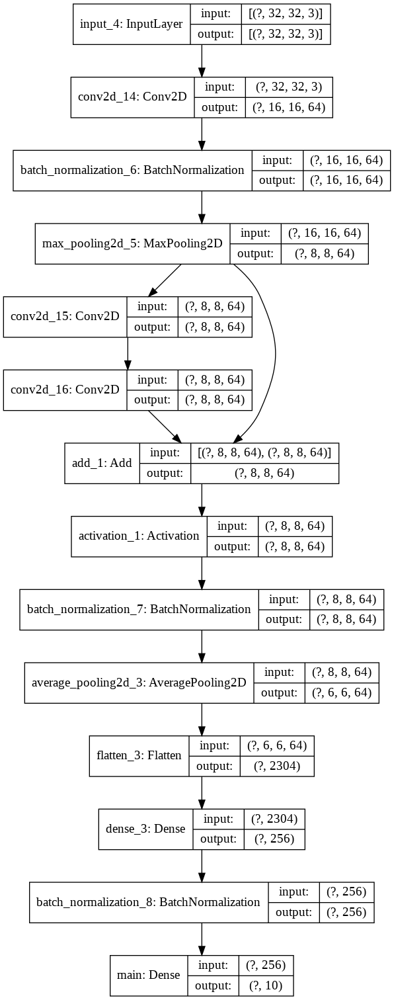

In [ ]:
import keras
keras.utils.plot_model(model, show_shapes=True)

### ONE BLOCK RESNET AUGMENTED IMAGES

In [ ]:

def resnet_1_augmented():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = residual_module(layer, 64)
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = resnet_1_augmented()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "1_resNET_augmented"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/RNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### ONE BLOCK RESNET LEARNING RATE = 0.00001

In [ ]:
adam_00001 = keras.optimizers.Adam(learning_rate=0.00001)

def resnet_1_LR_00001():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = residual_module(layer, 64)
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = resnet_1_LR_00001()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "1_resNET_LR_0.00001"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/RNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

## TWO BLOCKS RESNET

### TWO BLOCKS RESNET BATCH NORMALISATION

In [ ]:
def resnet_2():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = residual_module(layer, 64)
    layer = BatchNormalization()(layer)
    layer = residual_module(layer, 128)
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = resnet_2()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "resNET_2"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/RNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x, training_labels_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### TWO BLOCKS RESNET AUGMENTED IMAGES 

In [ ]:
def resnet_2_augmented():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = residual_module(layer, 64)
    layer = BatchNormalization()(layer)
    layer = residual_module(layer, 128)
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = resnet_2_augmented()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_resNET_augmented"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/RNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### TWO BLOCKS RESNET LEARNING RATE = 0.00001

In [ ]:
def resnet_2_LR_00001():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = residual_module(layer, 64)
    layer = BatchNormalization()(layer)
    layer = residual_module(layer, 128)
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = resnet_2_LR_00001()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_resNET_LR_0.00001"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/RNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

NameError: name 'model' is not defined

### TWO BLOCKS RESNET WEIGHTS REGULARISATION

Define residual block with weights regularisation

In [ ]:
from keras.regularizers import l2
reg_value = 0.001

def residual_module_WR(layer_in, n_filters):
	merge_input = layer_in
	
	if layer_in.shape[-1] != n_filters:
		merge_input = Conv2D(n_filters, (1,1), padding='same', activation='relu', kernel_initializer='he_normal', kernel_regularizer=l2(reg_value))(layer_in)

	conv1 = Conv2D(n_filters, (3,3), padding='same', activation='relu', kernel_initializer='he_normal', kernel_regularizer=l2(reg_value))(layer_in)

	conv2 = Conv2D(n_filters, (3,3), padding='same', activation='relu', kernel_initializer='he_normal', kernel_regularizer=l2(reg_value))(conv1)

	layer_out = add([conv2, merge_input])

	layer_out = Activation('relu')(layer_out)
	return layer_out

In [ ]:
def resnet_2_WR_00001():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu', kernel_regularizer=l2(reg_value))(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = residual_module_WR(layer, 64)
    layer = BatchNormalization()(layer)
    layer = residual_module_WR(layer, 128)
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu', kernel_regularizer=l2(reg_value))(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main', kernel_regularizer=l2(reg_value))(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = resnet_2_WR_00001()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_resNET_WR_0.001"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/RNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### TWO BLOCKS RESNET DROPOUT

In [ ]:
def resnet_2_dropout():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)
    layer = tf.keras.layers.Dropout(0.2)(layer)

    layer = residual_module(layer, 64)
    layer = BatchNormalization()(layer)
    layer = residual_module(layer, 128)
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    layer = tf.keras.layers.Dropout(0.35)(layer)

    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    layer = tf.keras.layers.Dropout(0.4)(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = resnet_2_dropout()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_resNET_dropout"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/RNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### TWO BLOCKS RESNET DROPOUT >100 EPOCHS

In [ ]:
def resnet_2_dropout_300_epochs():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)
    layer = tf.keras.layers.Dropout(0.2)(layer)

    layer = residual_module(layer, 64)
    layer = BatchNormalization()(layer)
    layer = residual_module(layer, 128)
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    layer = tf.keras.layers.Dropout(0.35)(layer)

    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    layer = tf.keras.layers.Dropout(0.4)(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model
    

model = resnet_2_dropout_300_epochs()

In [ ]:
epochs = 300
batch_size = 100

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_resNET_dropout_300_epochs"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/RNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### TWO BLOCKS RESNET DROPOUT EARLY STOPPING

In [ ]:
def resnet_2_dropout_early_stop():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)
    layer = tf.keras.layers.Dropout(0.2)(layer)

    layer = residual_module(layer, 64)
    layer = BatchNormalization()(layer)
    layer = residual_module(layer, 128)
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    layer = tf.keras.layers.Dropout(0.35)(layer)

    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    layer = tf.keras.layers.Dropout(0.4)(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model
    
    
model = resnet_2_dropout_early_stop()

In [ ]:
epochs = 500
batch_size = 100
es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=60)

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_resNET_dropout_early_stop_patience_60"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/RNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback, es], 
          verbose = 0);

### TWO BLOCKS RESNET GRAYSCALE

In [ ]:
def resnet_2_grayscale():
    layer_in = Input(shape=(32,32,1))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = residual_module(layer, 64)
    layer = BatchNormalization()(layer)
    layer = residual_module(layer, 128)
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = resnet_2_grayscale()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "2_resNET_grayscale"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/RNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_gray_aug, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x_gray, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

## THREE BLOCKS RESNET

### THREE BLOCKS RESNET BATCH NORMALISATION

In [ ]:
# fai
def resnet_3():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = residual_module(layer, 64)
    layer = BatchNormalization()(layer)
    layer = residual_module(layer, 128)
    layer = BatchNormalization()(layer)
    layer = residual_module(layer, 256)
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = resnet_3()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = "adam", loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "3_resNET"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/RNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x, training_labels_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);

### THREE BLOCKS RESNET AUGMENTED IMAGES + LEARNING RATE 0.00001

In [ ]:
def resnet_3_LR_00001():
    layer_in = Input(shape=(32,32,3))

    layer = Conv2D(filters=64, kernel_size=(3,3), strides=2, padding='same', activation='relu')(layer_in)
    layer = BatchNormalization()(layer)
    layer = MaxPooling2D(pool_size=(3,3), strides=2, padding='same')(layer)

    layer = residual_module(layer, 64)
    layer = BatchNormalization()(layer)
    layer = residual_module(layer, 128)
    layer = BatchNormalization()(layer)
    layer = residual_module(layer, 256)
    layer = BatchNormalization()(layer)
    
    layer = AveragePooling2D(pool_size=(3,3), strides=1, padding='valid')(layer)
    
    layer = Flatten()(layer)
    layer = Dense(units=256, activation='relu')(layer)
    layer = BatchNormalization()(layer)
    main = Dense(units=10, activation='softmax', name='main')(layer)
    
    model = Model(inputs=layer_in, outputs=[main])
    
    return model

model = resnet_3_LR_00001()

In [ ]:
epochs = 100
batch_size = 100

model.compile(optimizer = adam_00001, loss='categorical_crossentropy', metrics = [zero_one_loss, zero_one_loss_prop, 'accuracy'])

net_name = "3_resNET_LR_0.00001"

# log dir for saving TensorBoard logs
logdir = os.path.join("/content/gdrive/My Drive/fruits-360/conv_NN_models/RNET", net_name)

# callback to run TensorBoard
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [ ]:
model.fit(training_x_aug_2, training_labels_aug_2_onehot,
          epochs = epochs, 
          batch_size = batch_size,
          validation_data = (test_x, test_labels_onehot),
          callbacks = [tensorboard_callback], 
          verbose = 0);